## lyft-motion-prediction

In [16]:
import matplotlib.pyplot as plt
import numpy as np
from l5kit.data import ChunkedDataset, LocalDataManager
from l5kit.dataset import EgoDataset, AgentDataset

from l5kit.rasterization import build_rasterizer
from l5kit.configs import load_config_data
from l5kit.visualization import draw_trajectory, TARGET_POINTS_COLOR
from l5kit.geometry import transform_points
from tqdm import tqdm
from collections import Counter
from l5kit.data import PERCEPTION_LABELS
from prettytable import PrettyTable
import os

PATH_TO_DATA = "./input/lyft-motion-prediction-autonomous-vehicles"
os.environ["L5KIT_DATA_FOLDER"] = PATH_TO_DATA

In [20]:
cfg = {
    'format_version': 4,
    'model_params': {
        'model_architecture': 'resnet50',
        'history_num_frames': 0,
        'history_step_size': 1,
        'history_delta_time': 0.1,
        
        'future_num_frames': 50,
        'future_step_size': 1,
        'future_delta_time': 0.1
    },
    
    'raster_params': {
        'raster_size': [224, 224],
        'pixel_size': [0.5, 0.5],
        'ego_center': [0.25, 0.5],
        'map_type': 'py_semantic',
        'satellite_map_key': 'aerial_map/aerial_map.png',
        'semantic_map_key': 'semantic_map/semantic_map.pb',
        'dataset_meta_key': 'meta.json',
        'filter_agents_threshold': 0.5
    },
    
    'train_data_loader': {
        'key': 'scenes/train.zarr',
        'batch_size': 32,
        'shuffle': True,
        'num_workers': 4
    },
    
    'val_data_loader': {
        'key': 'scenes/validate.zarr',
        'batch_size': 12,
        'shuffle': False,
        'num_workers': 4
    },
    
    'test_data_loader': {
        'key': 'scenes/test.zarr',
        'batch_size' : 8,
        'shuffle': False,
        'num_workers': 4
    },
    
    'train_params': {
        'checkpoint_every_n_steps': 5000,
        'max_num_steps': 1000
    }
}

In [21]:
zarr_loc = cfg["train_data_loader"]["key"]
dm = LocalDataManager()
train_zarr = ChunkedDataset(dm.require(zarr_loc)).open()

#let's see what one of the objects looks like
print(train_zarr)

+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|   16265    |  4039527   | 320124624  |      112.19     |        248.36        |        79.25         |        24.83         |        10.00        |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+


### Let us visualize the EGO Dataset

In [22]:
rast = build_rasterizer(cfg, dm)
#Rasterisation is one of the typical techniques of rendering 3D models
dataset = EgoDataset(cfg, train_zarr , rast)

### For visualizaing the AV. AV stands for Autonomous Vehicle
### Let's get a sample from the dataset and use our rasterizer to get an RGB image we can plot


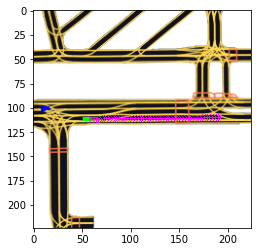

In [26]:
data = dataset[70]
im = data['image'].transpose(1,2,0)
im = dataset.rasterizer.to_rgb(im)
target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
plt.imshow(im[::-1])
plt.show()

* From what i can deduce the red box you see is the intersection entry wait line for ego car
* If it is yellow means an intersection entry wait line for other cars while Green is intersection exit line

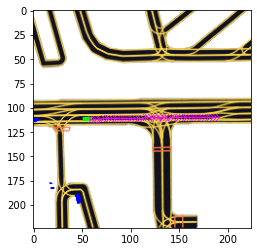

In [27]:
#Let visualize other images
data = dataset[30]
im = data['image'].transpose(1,2,0)
im = dataset.rasterizer.to_rgb(im)
target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
plt.imshow(im[::-1])
plt.show()

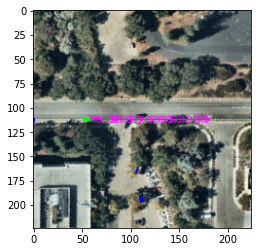

In [28]:
# Let me try visualizing image through another rasterizer
cfg["raster_params"]["map_type"] = "py_satellite"
rast = build_rasterizer(cfg, dm)
dataset = EgoDataset(cfg, train_zarr, rast)
data = dataset[2]

im = data["image"].transpose(1,2,0)
im = dataset.rasterizer.to_rgb(im)
target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
plt.imshow(im[::-1])
plt.show()

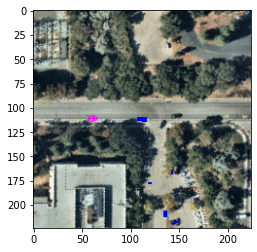

In [31]:
# There are two ways in which our self driving car could go it can either continue going, 
# straight or it can make a turn to the right hand side
# visualizng an agent
dataset = AgentDataset(cfg, train_zarr, rast)
data = dataset[0]

im = data["image"].transpose(1, 2, 0)
im = dataset.rasterizer.to_rgb(im)
target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
plt.imshow(im[::-1])
plt.show()

Animation size has reached 21074317 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


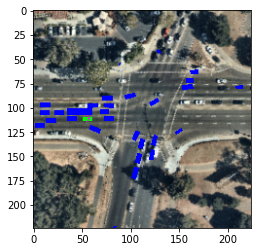

In [35]:
from IPython.display import display, clear_output
from IPython.display import HTML

import PIL
import matplotlib.pyplot as plt
from matplotlib import animation, rc
def animate_solution(images):
    def animate(i):
        im.set_data(images[i])
        
    fig, ax = plt.subplots()
    im = ax.imshow(images[0])
    
    return animation.FuncAnimation(fig, animate, frames=len(images), interval=60)

cfg["raster_params"]["map_type"] = "py_satellite"
rast = build_rasterizer(cfg, dm)
dataset = EgoDataset(cfg, train_zarr, rast)
scene_idx = 34
indexes = dataset.get_scene_indices(scene_idx)
images = []

for idx in indexes:
    data = dataset[idx]
    im = data["image"].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
    center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
    draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
    clear_output(wait=True)
    images.append(PIL.Image.fromarray(im[::-1]))
anim = animate_solution(images)
HTML(anim.to_jshtml())

In [ ]:
dataset = setaset_dict["py_semantic"]
scene_idx = 34
anim = create_animate_for_scene(dataset, scene_idx)
print("scene_idx, sceneidx)")